In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
from ipywidgets import widgets
from IPython.display import display
from ipywidgets import interact

# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML


## Camera Calibration

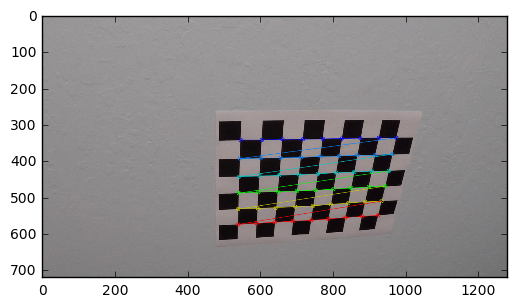

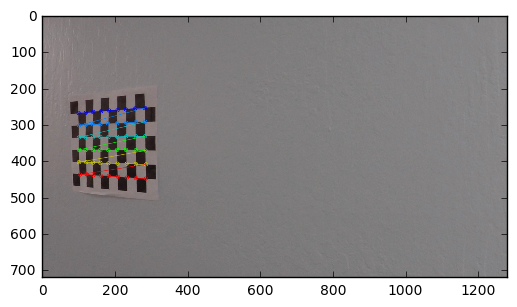

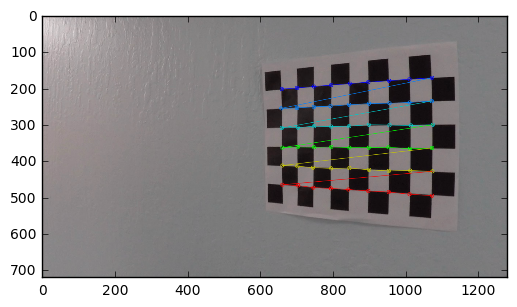

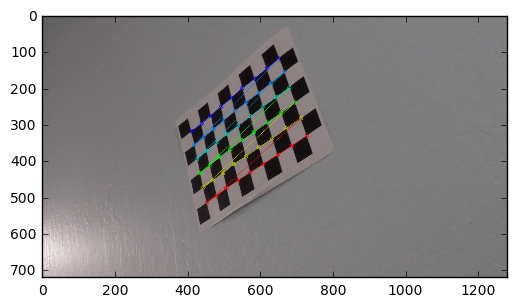

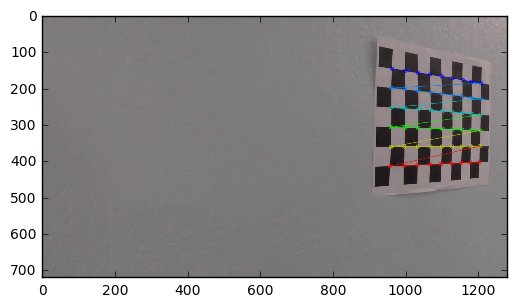

...

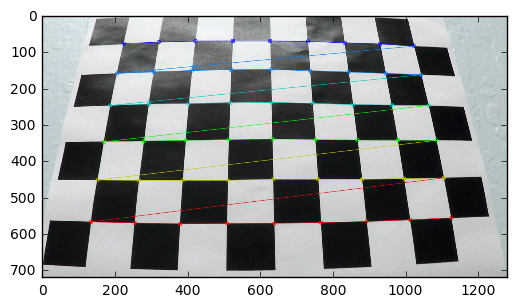

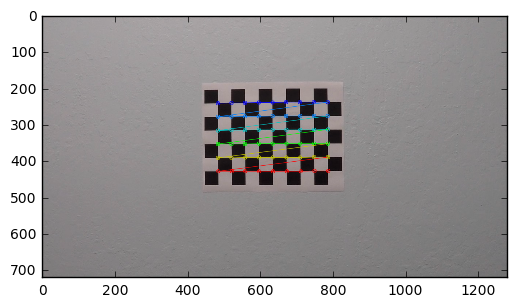

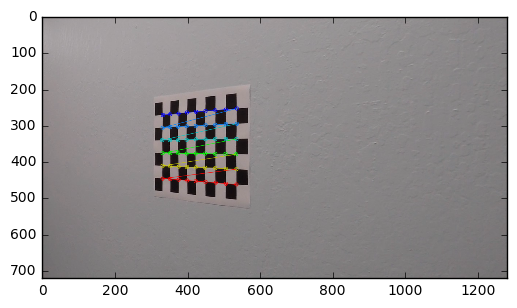

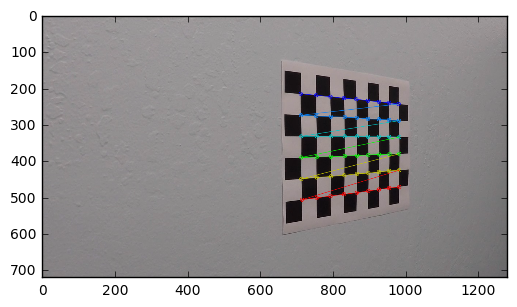

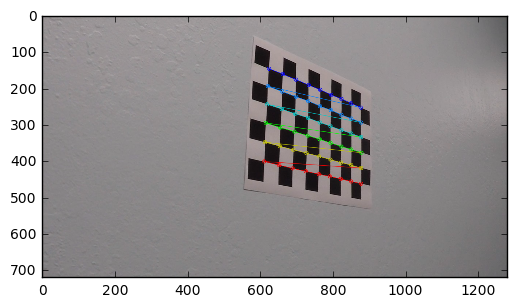

In [2]:
# Read all the calibration images
cal_images_paths = glob.glob('./camera_cal/calibration*.jpg')

objpoints = []  # 3D points in real world space
imgpoints = []  # 2D points in image plane

#Prepare object poiints to represent the corners 
objp = np.zeros((9*6,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)


for path in cal_images_paths:
    #Read each image
    cal_img = cv2.imread(path)
    
    #Convert to grayscale as the findchessboardcorners works with grayscale image
    gray = cv2.cvtColor(cal_img,cv2.COLOR_BGR2GRAY)
    
    #Find Chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6), None)
    
    #If corners are found, then add object and image points
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)
        
        #Draw detected corners and display them
        img = cv2.drawChessboardCorners(cal_img, (9,6), corners, ret)
        plt.imshow(img)
        plt.show()

    
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)


## Distortion correction

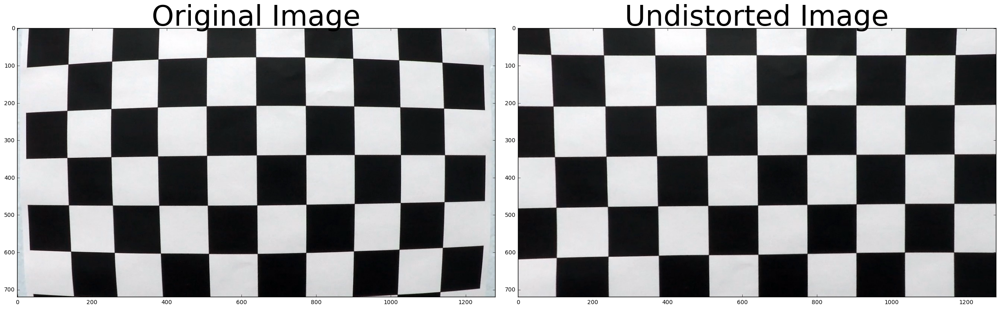

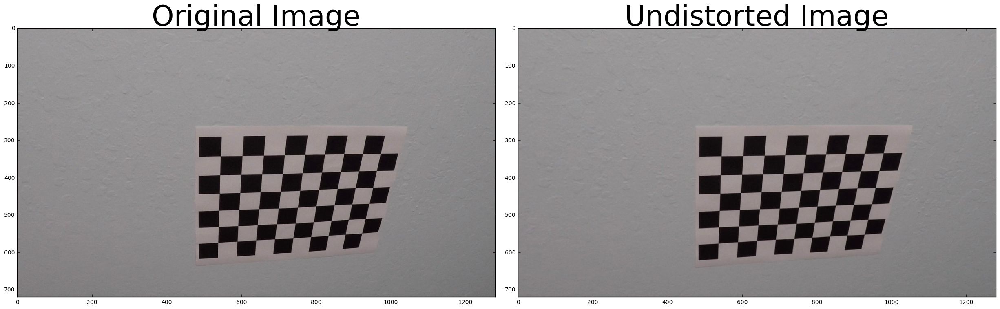

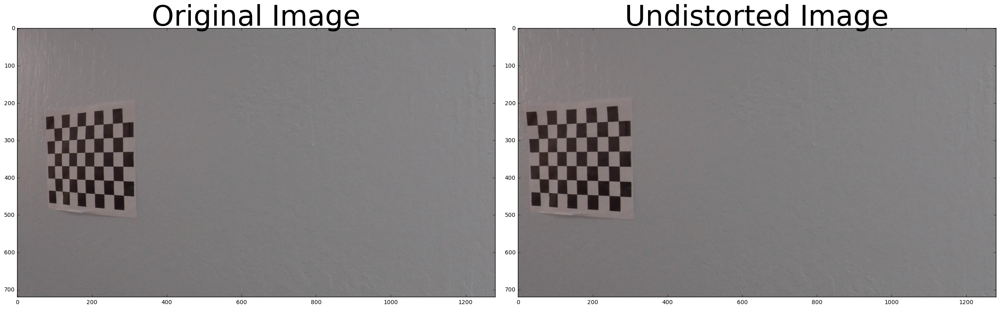

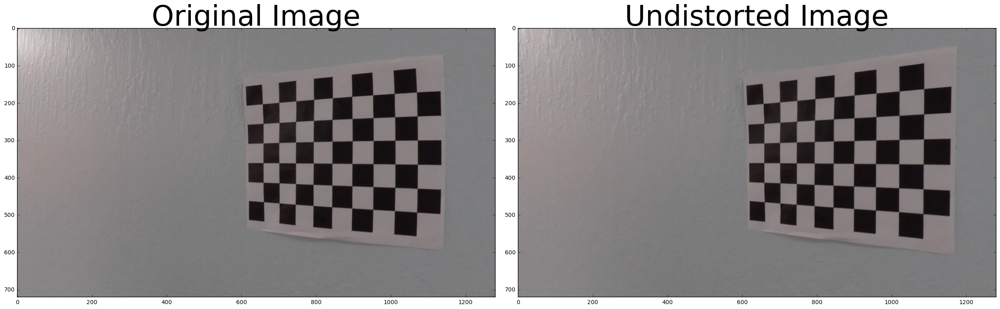

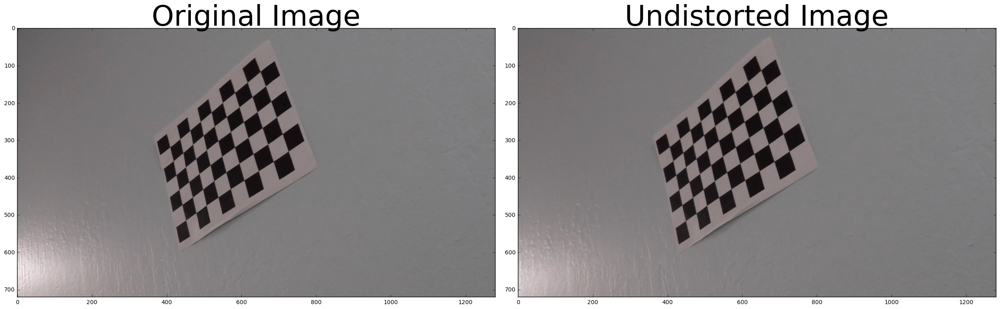

...

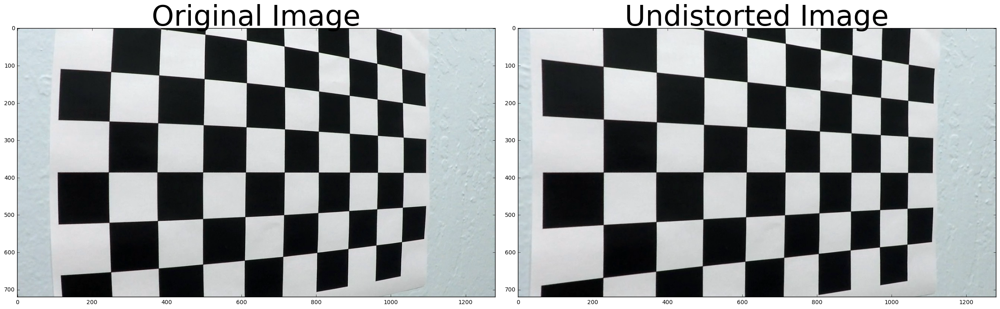

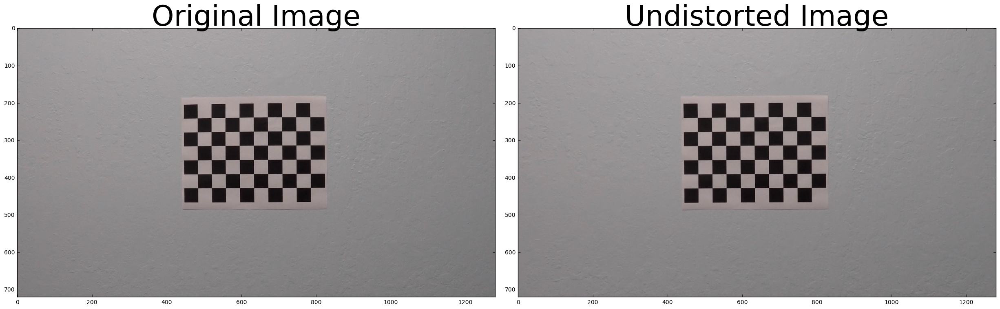

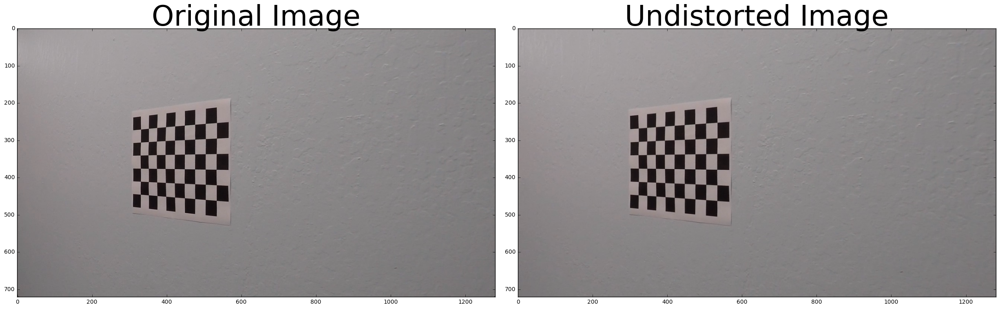

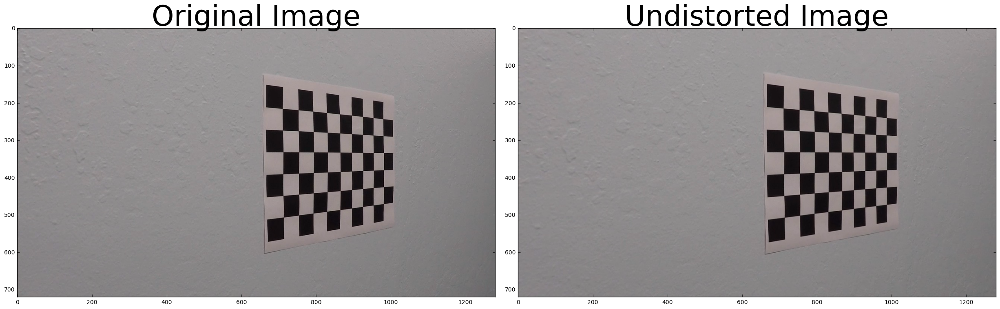

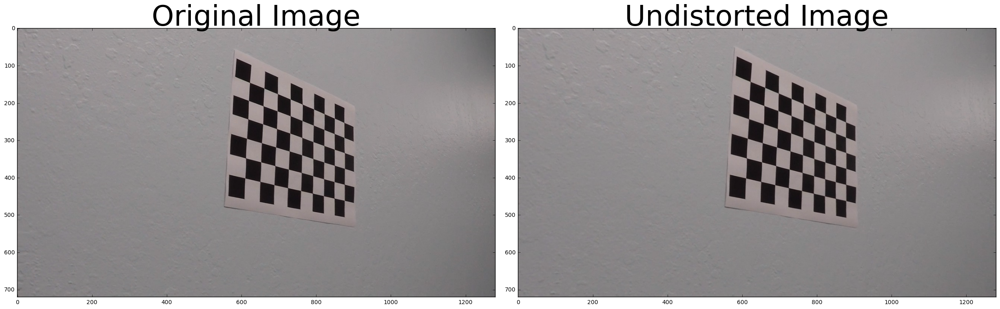

In [3]:
#Validate if the distortion correction is working properly
for path in cal_images_paths:
    #Read each image
    org_img = cv2.imread(path)
    undist_img = cv2.undistort(org_img, mtx, dist, None, mtx)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(org_img)
    ax1.set_title('Original Image', fontsize=50)
    ax2.imshow(undist_img)
    ax2.set_title('Undistorted Image', fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()
    
def undistort_image(img):
    undist_img = cv2.undistort(img, mtx, dist, None, mtx)
    return undist_img


## Color/gradient threshold 

In [4]:
def color_grad_thresh(img):
    
    #Detect yellow and white lines seperately using HSV colorspace.
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    yellow_hsv_low  = np.array([ 0, 80, 100])
    yellow_hsv_high = np.array([ 40, 255, 255])
    yellow_mask = cv2.inRange(hsv, yellow_hsv_low, yellow_hsv_high)
    white_hsv_low  = np.array([  20,   0,   180])
    white_hsv_high = np.array([ 255,  80, 255])
    white_mask = cv2.inRange(hsv, white_hsv_low, white_hsv_high)
    mask_lane = cv2.bitwise_or(yellow_mask,white_mask)
 
    
    # Convert to HLS color space and separate the S and L channel
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    l_channel = hls[:,:,1]
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    # Threshold x gradient
    thresh_min = 50
    thresh_max = 225
    l_sxbinary = np.zeros_like(scaled_sobel)
    l_sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    
    s_channel = hls[:,:,2]
    sobelx = cv2.Sobel(s_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    # Threshold x gradient
    thresh_min = 50
    thresh_max = 225
    s_sxbinary = np.zeros_like(scaled_sobel)
    s_sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    
    # Combine sobel filter information from L and S channels.
    sxbinary = cv2.bitwise_or(l_sxbinary,s_sxbinary)
    #sxbinary = cv2.GaussianBlur(sxbinary,(5,5),0)
    
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(mask_lane >= 0.5) | (sxbinary >= 0.5)] = 1
    #plt.imshow(combined_binary, cmap='gray')
    #plt.show()
    
    return combined_binary

## Perspective transform

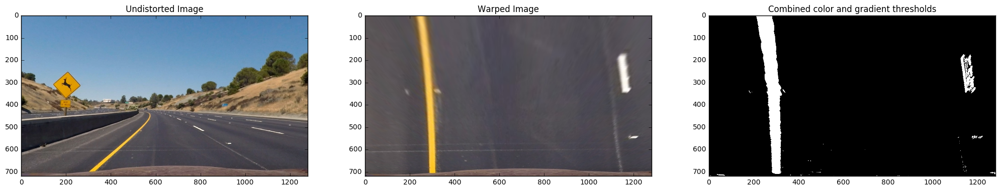

In [5]:
%matplotlib inline

def warp_image(img,inverse = False):
    
    image_size = (img.shape[1], img.shape[0])
    
    ht = 480
    src = np.float32([[548, ht], 
                      [740, ht], 
                      [image_size[0]-150, image_size[1]],
                      [190, image_size[1]]])
    dest = np.float32([[200,0],
                       [1130,0],
                       [1130,720],
                       [200,720]])
    

    #Compute Perspective matrix
    M = cv2.getPerspectiveTransform(src, dest)
    
    Minv = cv2.getPerspectiveTransform(dest, src)
    
    if inverse == True:
        warped_img = cv2.warpPerspective(img, Minv, image_size)
    else:
        #Create Warped image using Linear intrapolation
        warped_img = cv2.warpPerspective(img, M, image_size, flags=cv2.INTER_LINEAR)
    
    return warped_img

img = cv2.imread('./test_images/test2.jpg')
undist_img = undistort_image(cv2.cvtColor(img,cv2.COLOR_BGR2RGB))

warped_img = warp_image(undist_img)

colorgrad_img = color_grad_thresh(warped_img)
u = (1,25,2)
v = (0,255,1)
#interact(color_grad_thresh,tmin=v,tmax=v,kernel=u)    

# Plotting thresholded images
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(25,10))
ax1.set_title('Undistorted Image')
ax1.imshow(undist_img)

ax2.set_title('Warped Image')
ax2.imshow(warped_img)

ax3.set_title('Combined color and gradient thresholds')
ax3.imshow(colorgrad_img, cmap='gray')




#interact(warp_image,s11=v,s12=v,s21=v,s22=v,s31=v,s32=v,s41=v,s42=v,d11=v,d12=v,d21=v,d22=v,d31=v,d32=v,d41=v,d42=v)


## Detect lane lines

In [6]:
%matplotlib inline

def draw_fit(img, fit):
    y = np.linspace(0, img.shape[0]-1, img.shape[0])
    x = fit[0] * y**2 + fit[1] * y + fit[2]
    pts = np.array([np.transpose(np.vstack([x, y]))])
    cv2.polylines(img, np.int_(pts), isClosed=False, color=(255,255,0), thickness=3)
    return img

def fit_poly_from_scratch(img, left_lane, right_lane, visualize=False):
    
    # Take a histogram of the bottom half of the image
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((img, img, img))*255

    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(img.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window+1)*window_height
        win_y_high = img.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
        
    #Calculate radius of curvature
    left_curverad, right_curverad = calculat_radius_of_curvature(leftx, lefty, rightx, righty)
    
    #Update Lane object
    left_lane.detected = True
    right_lane.detected = True
    left_lane.current_fit = left_fit
    right_lane.current_fit = right_fit    
    left_lane.radius_of_curvature = left_curverad
    right_lane.radius_of_curvature = right_curverad    
    left_lane.allx = leftx
    left_lane.ally = lefty
    right_lane.allx = rightx
    right_lane.ally = righty
    
    if visualize == True:
        # Generate x and y values for plotting
        ploty = np.linspace(0, out_img.shape[0]-1, out_img.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
        plt.imshow(out_img)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)

    return out_img

def fit_poly_from_prev(img, left_lane, right_lane, visualize=False):
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    left_fit = left_lane.current_fit
    right_fit = right_lane.current_fit
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 150
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
    left_fit[1]*nonzeroy + left_fit[2] + margin))) 

    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
    right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    
    out_img = np.dstack((img, img, img))*255
        
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)   
    
    #Calculate radius of curvature
    left_curverad, right_curverad = calculat_radius_of_curvature(leftx, lefty, rightx, righty)
    
    #Update Lane object
    left_lane.detected = True
    right_lane.detected = True       
    left_lane.current_fit = left_fit
    right_lane.current_fit = right_fit    
    left_lane.radius_of_curvature = left_curverad
    right_lane.radius_of_curvature = right_curverad    
    left_lane.allx = leftx
    left_lane.ally = lefty
    right_lane.allx = rightx
    right_lane.ally = righty
    
    if visualize == True:
        ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
        # Create an image to draw on and an image to show the selection window    
        window_img = np.zeros_like(out_img)
        # Color in left and right line pixels
        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

        # Generate a polygon to illustrate the search window area
        # And recast the x and y points into usable format for cv2.fillPoly()
        left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
        left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                                      ploty])))])
        left_line_pts = np.hstack((left_line_window1, left_line_window2))
        right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
        right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                                      ploty])))])
        right_line_pts = np.hstack((right_line_window1, right_line_window2))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
        cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
        result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
        #plt.imshow(result)
        #plt.plot(left_fitx, ploty, color='yellow')
        #plt.plot(right_fitx, ploty, color='yellow')
        #plt.xlim(0, 1280)
        #plt.ylim(720, 0)
        
        out_img = draw_fit(result, left_fit)
        out_img = draw_fit(result, right_fit)
    
    return out_img

def get_val(y,poly):
    # Returns value of a quadratic polynomial 
    return poly[0]*y**2+poly[1]*y+poly[2]

def calculat_radius_of_curvature(leftx, lefty, rightx, righty):
    
    yvalue = 720/2
    
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension

    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*yvalue*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*yvalue*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    return left_curverad, right_curverad

In [7]:
%matplotlib inline

class Lane():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        #polynomial coefficients for the most recent fit
        self.current_fit = None  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        #Count No of continuous frames where it couldnt detect the lane
        self.bad_count = 0


def lane_sanity_check(left_lane, right_lane, prev_left_lane, prev_right_lane):
    #To handle first frame cases where there is no prev frame. We set prev frame to current frame 
    if prev_left_lane.current_fit == None:
        prev_left_lane.current_fit = left_lane.current_fit
        prev_left_lane.allx = left_lane.allx
        prev_left_lane.ally = left_lane.ally
    if prev_right_lane.current_fit == None:
        prev_right_lane.current_fit = right_lane.current_fit
        prev_right_lane.allx = right_lane.allx
        prev_right_lane.ally = right_lane.ally
      
    ## Check error between left lane current and previous coefficient
    err_coeff_prev_curr = np.sum((left_lane.current_fit[0]-prev_left_lane.current_fit[0])**2) 
    err_coeff_prev_curr = np.sqrt(err_coeff_prev_curr)
    if err_coeff_prev_curr>.0005:
        left_lane.detected = False
        left_lane.current_fit = .85*prev_left_lane.current_fit+.15*left_lane.current_fit
        left_lane.allx = prev_left_lane.allx
        left_lane.ally = prev_left_lane.ally
    else:
        left_lane.current_fit = .65*left_lane.current_fit+.35*prev_left_lane.current_fit
 
    
    ## Check error between right lane current and previous coefficient
    err_coeff_prev_curr = np.sum((right_lane.current_fit[0]-prev_right_lane.current_fit[0])**2) 
    err_coeff_prev_curr = np.sqrt(err_coeff_prev_curr)
    if err_coeff_prev_curr>.0005:
        right_lane.detected = False
        right_lane.current_fit = .85*prev_right_lane.current_fit+.15*right_lane.current_fit
        right_lane.allx = prev_right_lane.allx
        right_lane.ally = prev_right_lane.ally 
    else:
        right_lane.current_fit = .65*right_lane.current_fit+.35*prev_right_lane.current_fit
     
    if left_lane.detected:
        left_lane.bad_count = 0
    else:
        left_lane.bad_count = left_lane.bad_count + 1
    
    if right_lane.detected:
        right_lane.bad_count = 0
    else:
        right_lane.bad_count = right_lane.bad_count + 1
                    
def lane_detect_pipeline(img, left_lane, right_lane, prev_left_lane, prev_right_lane, scratch=True, diag=False):
    undist_img = undistort_image(img)
    warped_img = warp_image(undist_img)
    binary_colorgrad_img = color_grad_thresh(warped_img)
    
    #If there are 12 consecutive bad frames then detect lane from scratch
    if left_lane.bad_count > 12 or right_lane.bad_count >12:
        scratch = True
        
    #if (prev_left_lane.detected == False or prev_right_lane.detected == False):
    if(scratch == True):
        out_img = fit_poly_from_scratch(binary_colorgrad_img, left_lane, right_lane)
    else:
        out_img = fit_poly_from_prev(binary_colorgrad_img, left_lane, right_lane, visualize=True)
    
    #Check for detected lane sanity. If bad use data from previous frames
    lane_sanity_check(left_lane, right_lane, prev_left_lane, prev_right_lane)
    
    #Re-calculate radius of curvature
    left_lane.radius_of_curvature, right_lane.radius_of_curvature = calculat_radius_of_curvature(left_lane.allx, left_lane.ally, right_lane.allx, right_lane.ally)
    #print(left_lane.radius_of_curvature, 'm', right_lane.radius_of_curvature, 'm')
    
       
    ## Compute intercepts
    left_bot = get_val(img.shape[0],left_lane.current_fit)
    right_bot = get_val(img.shape[0],right_lane.current_fit)
     
    ## Compute center location
    val_center = (left_bot+right_bot)/2.0
    
    ## Compute lane offset
    dist_offset = val_center - img.shape[1]/2
    dist_offset = np.round(dist_offset/2.81362,2)
    str_offset = 'Lane deviation: ' + str(dist_offset) + ' cm.'
    str_curv = 'Curvature: Left = ' + str(np.round(left_lane.radius_of_curvature,2)) + ', Right = ' + str(np.round(right_lane.radius_of_curvature,2))
    
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0])
    left_fitx = left_lane.current_fit[0]*ploty**2 + left_lane.current_fit[1]*ploty + left_lane.current_fit[2]
    right_fitx = right_lane.current_fit[0]*ploty**2 + right_lane.current_fit[1]*ploty + right_lane.current_fit[2]
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_colorgrad_img).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    
    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    
    # Draw the lane onto the warped blank image    
    if(left_lane.detected):
        cv2.polylines(color_warp, np.int_([pts_left]), isClosed=False, color=(0,0,255), thickness=50)
    else:
        cv2.polylines(color_warp, np.int_([pts_left]), isClosed=False, color=(255,0,0), thickness=50)

    if(right_lane.detected):
        cv2.polylines(color_warp, np.int_([pts_right]), isClosed=False, color=(0,0,255), thickness=50)
    else:
        cv2.polylines(color_warp, np.int_([pts_right]), isClosed=False, color=(255,0,0), thickness=50)
        
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = warp_image( color_warp, inverse = True) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist_img, 1, newwarp, 0.5, 0)     
    
    # Change color if distance is more than 32 cm
    font = cv2.FONT_HERSHEY_COMPLEX    
    cv2.putText(result, str_curv, (30, 60), font, 1, (0,255,0), 2)

    if dist_offset<32:
        cv2.putText(result, str_offset, (30, 90), font, 1, (0,255,0), 2)
    else:
        cv2.putText(result, str_offset, (30, 90), font, 1, (255,0,0), 2)
        
    #Update Prev Lane objects
    prev_left_lane = left_lane
    prev_right_lane = right_lane
    
    diag_img = out_img
    
    if diag:
        # Calculate the size of screens
        result_screen_w = result.shape[1]
        result_screen_h = result.shape[0]
        diag_screen_w = np.int(result_screen_w / 3)
        diag_screen_h = np.int(result_screen_h / 3)
        screen_w = result_screen_w + diag_screen_w
        screen_h = result_screen_h
        # Assign result image to the screen
        screen = np.zeros((screen_h, screen_w, 3), dtype=np.uint8)
        screen[0:result_screen_h, 0:result_screen_w] = result
        # Assgin diagnosis image to the screen
        diag_img_1 = warped_img
        screen[0:diag_screen_h, result_screen_w:, :] = cv2.resize(diag_img_1, (diag_screen_w, diag_screen_h))
        diag_img_2 = np.dstack((binary_colorgrad_img, binary_colorgrad_img, binary_colorgrad_img))*255
        screen[diag_screen_h : diag_screen_h*2, result_screen_w:, :] = cv2.resize(diag_img_2, (diag_screen_w, diag_screen_h))
        screen[diag_screen_h*2 : diag_screen_h*3, result_screen_w:, :] = cv2.resize(diag_img, (diag_screen_w, diag_screen_h))
        plt.imshow(screen)
        plt.show()
        return screen
    else:
        return result

    
#Test with sample images
for i, imgName in enumerate(glob.glob('./test_images/test*.jpg')):
    img = cv2.imread(imgName)
    left_lane = Lane()
    right_lane = Lane()
    prev_right_lane = Lane()
    prev_left_lane = Lane()
    lane_detect_pipeline(cv2.cvtColor(img,cv2.COLOR_BGR2RGB), left_lane, right_lane, prev_left_lane, prev_right_lane)


In [8]:
global scratch
scratch = True
def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image where lines are drawn on lanes)
    global scratch
    result = lane_detect_pipeline(image, left_lane, right_lane, prev_left_lane, prev_right_lane, scratch)
    scratch = False
    
    return result

prev_left_lane = Lane()
prev_right_lane = Lane()
left_lane = Lane()
right_lane = Lane()
white_output = 'test_videos_output/challenge_video.mp4'
clip1 = VideoFileClip("test_videos/challenge_video.mp4")
white_clip = clip1.fl_image(process_image) 
%time white_clip.write_videofile(white_output, audio=False)

#harder_challenge_video
#project_video
#challenge_video

[MoviePy] >>>> Building video test_videos_output/challenge_video.mp4
[MoviePy] Writing video test_videos_output/challenge_video.mp4


100%|████████████████████████████████████████| 485/485 [01:15<00:00,  6.82it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/challenge_video.mp4 

Wall time: 1min 16s
